# Mask R-CNN Demo

A quick intro to using the pre-trained model to detect and segment objects.

In [1]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [20]:
import os, sys, random, math, glob

import imageio
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.ndimage.morphology import binary_fill_holes
from skimage.transform import resize
from skimage.io import imread, imshow, imread_collection, concatenate_images
from pathlib import Path
import cv2
%matplotlib inline

In [5]:
from mrcnn import utils, visualize, model as modellib
from mrcnn.config import Config

In [6]:
# Directory to save logs and trained model
MODEL_DIR = os.path.join('../models')

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(MODEL_DIR, 'mask_rcnn_coco.h5')

## Configurations

We'll be using a model trained on the MS-COCO dataset. The configurations of this model are in the ```CocoConfig``` class in ```coco.py```.

For inferencing, modify the configurations a bit to fit the task. To do so, sub-class the ```CocoConfig``` class and override the attributes you need to change.

In [7]:
class CocoConfig(Config):
    """Configuration for training on MS COCO.
    Derives from the base Config class and overrides values specific
    to the COCO dataset.
    """
    # Give the configuration a recognizable name
    NAME = 'coco'
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    # Number of classes (including background)
    NUM_CLASSES = 1 + 80  # COCO has 80 classes

config = CocoConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                93
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

## Create Model and Load Trained Weights

In [8]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
model.load_weights(COCO_MODEL_PATH, by_name=True)

Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.


## Custom class wrapper for CloMask images

In [21]:
class ClomaskDataset(object):
    def __init__(self, folder, image_id, fake=False):
        self.IMAGE_DIR = Path('../data/%s'%folder)
        if fake:
            self.IMAGE_PATH = os.path.join(self.IMAGE_DIR, 'train_image', image_id)
        else:
            self.IMAGE_PATH = os.path.join(self.IMAGE_DIR, image_id)
        self.IMAGE_ID = image_id
        self.DESC = folder
        self.CLASS_ID = 74

    def load_image(self):
        img = cv2.imread(self.IMAGE_PATH)
        img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
        return img
    
    def load_mask(self):
        complete_mask = []
        for mask_file in tqdm(glob.glob(os.path.join(self.IMAGE_DIR, 'train_mask', '*')), desc='Masks'):
            if 'jpg' in mask_file:
                single_mask = cv2.imread(mask_file, 0)
                if len(single_mask.shape) > 2:
                    single_mask = single_mask[:, :, 0]
                    print(single_mask.shape)
                # binary_holes filling
                single_mask = binary_fill_holes(single_mask).astype(np.int32)
                # check for mask to be atleast 1 pixel
                if np.sum(single_mask) >= 1:
                    complete_mask.append(np.squeeze(single_mask))
        complete_mask = np.stack(complete_mask, axis=-1)
        complete_mask = complete_mask.astype(np.uint8)
        class_ids = np.zeros(complete_mask.shape[2])
        class_ids[:] = self.CLASS_ID
        class_ids = class_ids.astype(np.int8)
        return complete_mask, class_ids

In [22]:
test = ClomaskDataset('fake-boxes/synth_data_2019_01_23_03_30_55/image_0_2019_01_23_03_30_55', 'image_0_2019_01_23_03_30_55', fake=True)
test_mask, test_ids = test.load_mask()

Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 89/89 [01:03<00:00,  1.42it/s]


In [33]:
# COCO Class names
# Index of the class in the list is its ID. For example, to get ID of
# the teddy bear class, use: class_names.index('teddy bear')
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'box', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

def eval_single(folder, image_file, filter_box=True, fake=False):
    clomask = ClomaskDataset(folder, image_file, fake)
    image = clomask.load_image()
    result = model.detect([image], verbose=0)[0]
    pred_box, pred_class_id, pred_score, pred_mask = result['rois'], result['class_ids'], result['scores'], result['masks']
    
    if fake:
        fig, axes = plt.subplots(1, 3, figsize=(16,9))
        gt_mask, gt_class_id = clomask.load_mask()
        axes[2].imshow(gt_mask.sum(axis=-1),cmap='hot')
        axes[2].set_title('Actual Mask')
    else:
        fig, axes = plt.subplots(1, 2, figsize=(16,9))
        
    axes[0].imshow(image)
    axes[0].set_title('Original Image')
    
    if filter_box:
        box_filter = (pred_class_id == 74)
        print("Number of boxes detected = %i" %len(box_filter[box_filter==True]))
    else:
        box_filter = [True] * len(pred_class_id)
    
    visualize.display_instances(image, pred_box[box_filter], pred_mask[:, :, box_filter], pred_class_id[box_filter], 
                                class_names, pred_score[box_filter], ax=axes[1])
    
    if fake:
        gt_box = utils.extract_bboxes(gt_mask)
        mAP = utils.compute_ap_range(gt_box, gt_class_id, gt_mask,
                                     pred_box[box_filter], pred_class_id[box_filter], pred_score[box_filter], pred_mask[:, :, box_filter],
                                     iou_thresholds=None, verbose=0)
        axes[1].set_title('Predicted Mask with MAP = %0.3f' %mAP)
    else:
        axes[1].set_title('Predicted Mask')
    plt.show()

Boxes in a Fridge
---
Observations:
- Not too well
- Might be interesting to figure out why certain boxes are recognized but not others?

Number of boxes detected = 1


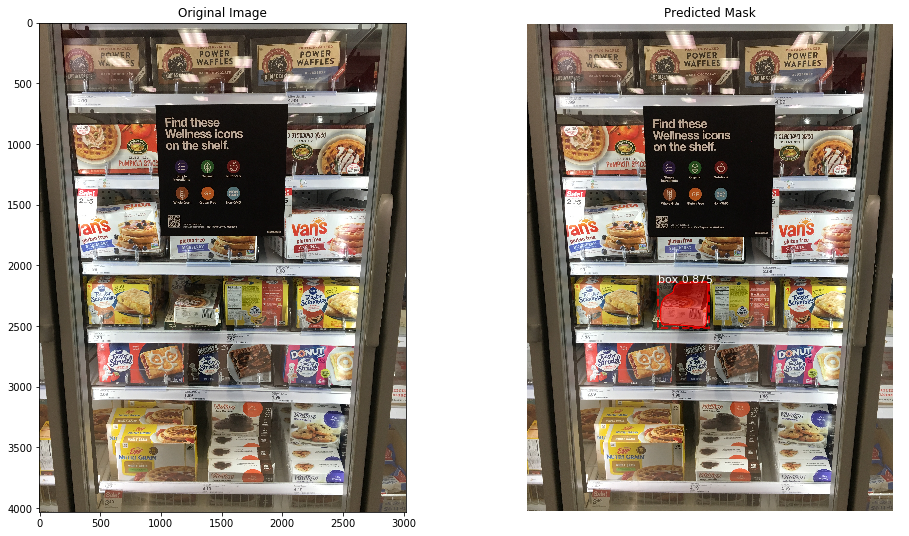

Number of boxes detected = 5


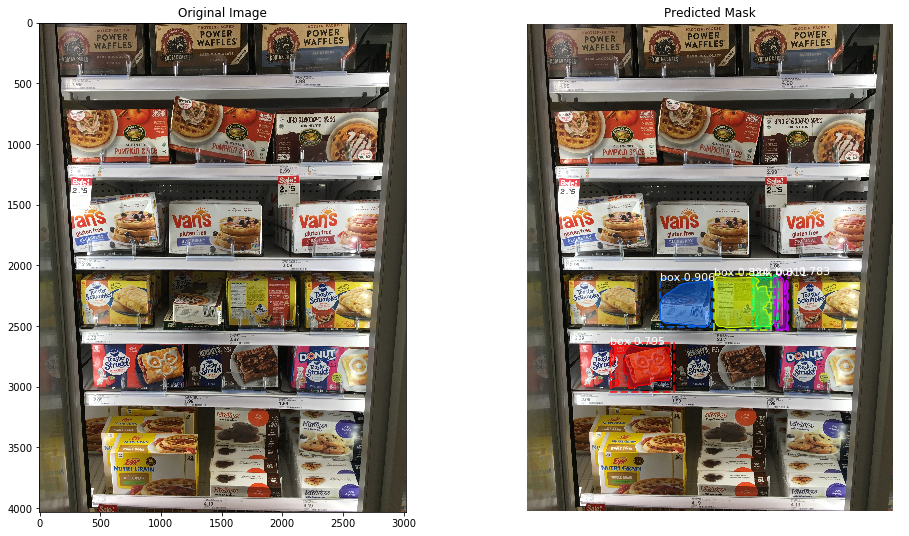

Number of boxes detected = 5


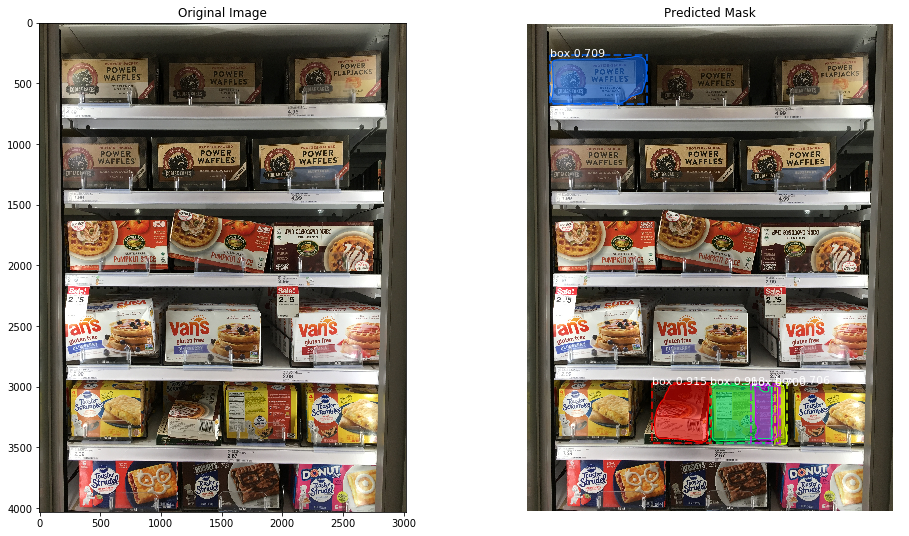

Number of boxes detected = 1


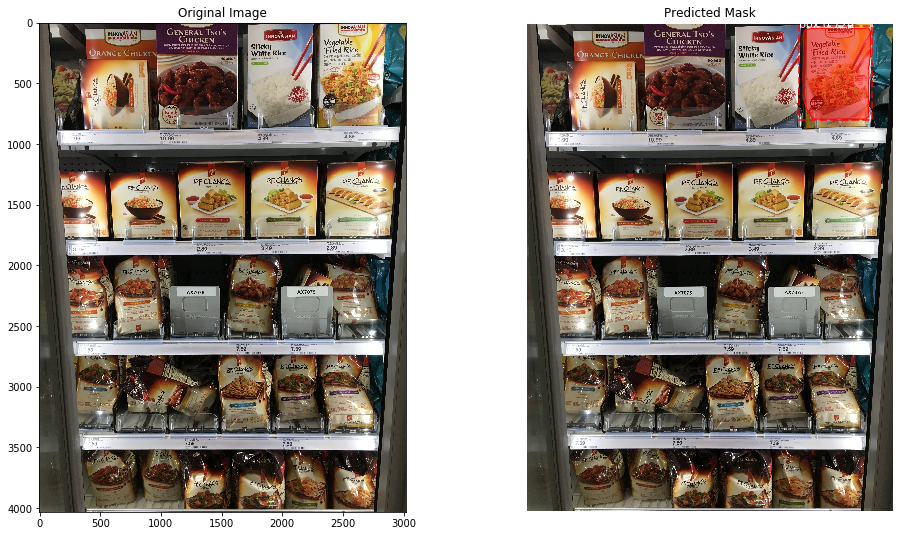

In [67]:
image_tag = 'box-fridge-eval'
for path in glob.glob('../data/%s/*'%image_tag):
    eval_single(image_tag, path[-12:])

Boxes on a Shelf
---
Observations:
- Angles and color differentiation might affect performance (green boxes, tiger boxes)
- Only a certain type of boxes get recognized well. Those that are clearly a cereal box looking, probably abundant in the COCO dataset. Other unique boxes are not doing so well.
- Obstacles (human standing in front or random objects)
- Might be interesting to figure out why certain boxes are recognized but not others?

Number of boxes detected = 4


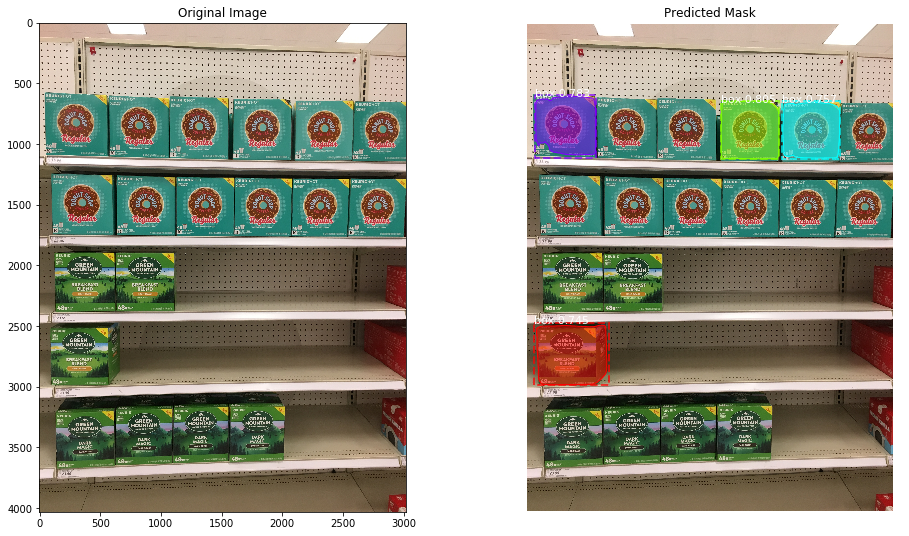

Number of boxes detected = 10


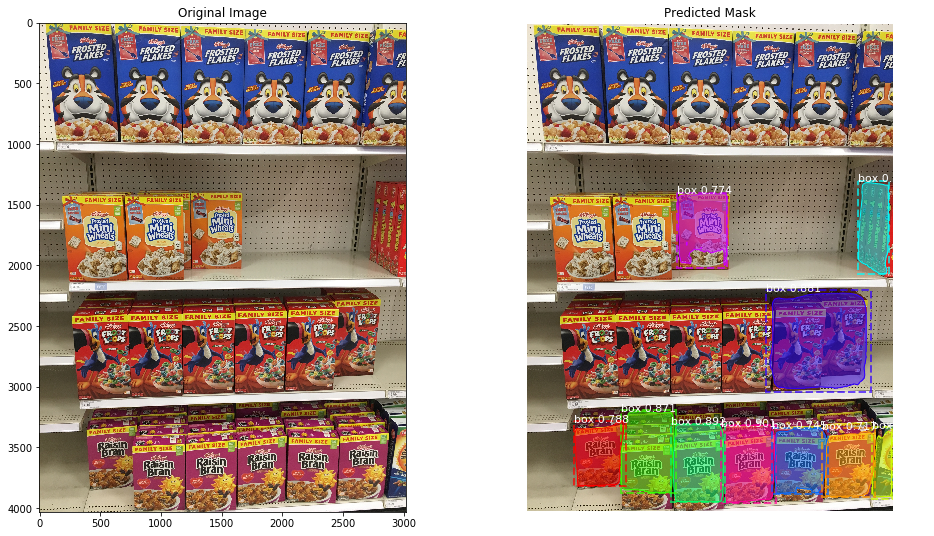

Number of boxes detected = 23


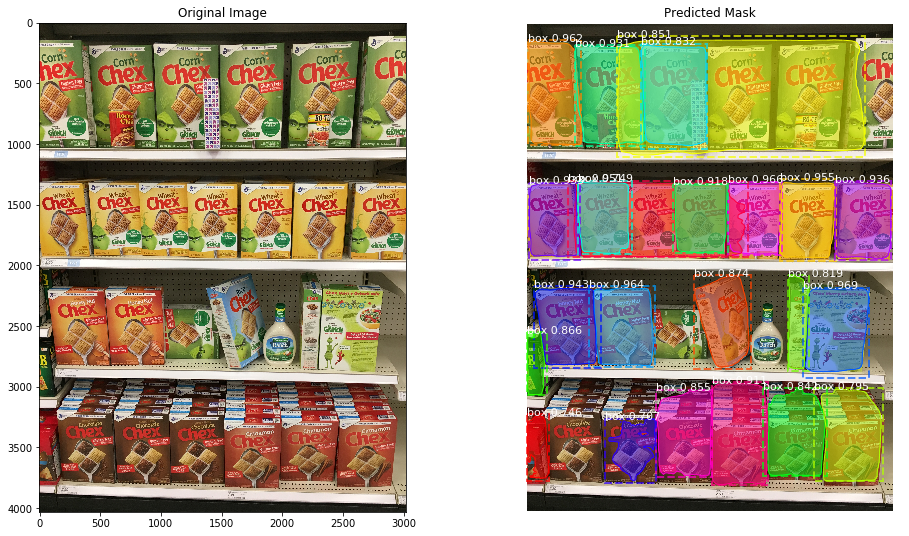

Number of boxes detected = 22


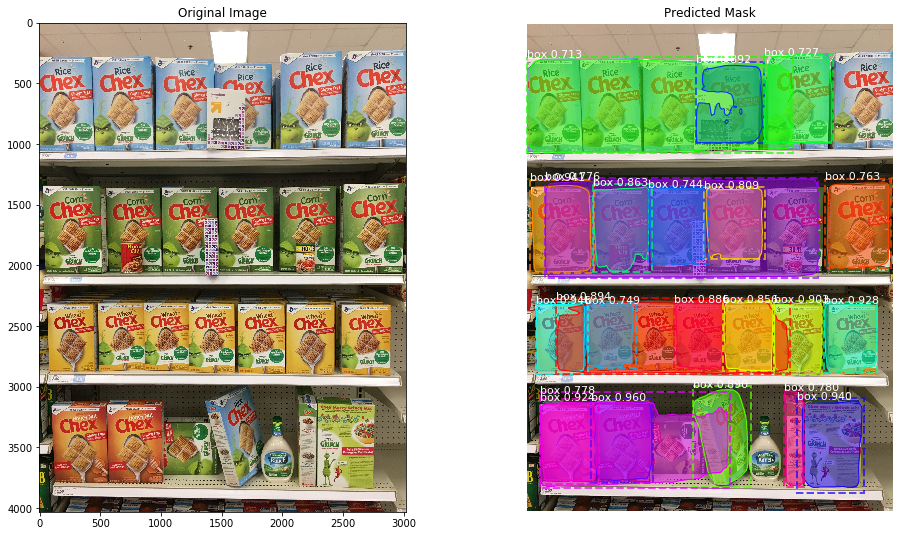

Number of boxes detected = 11


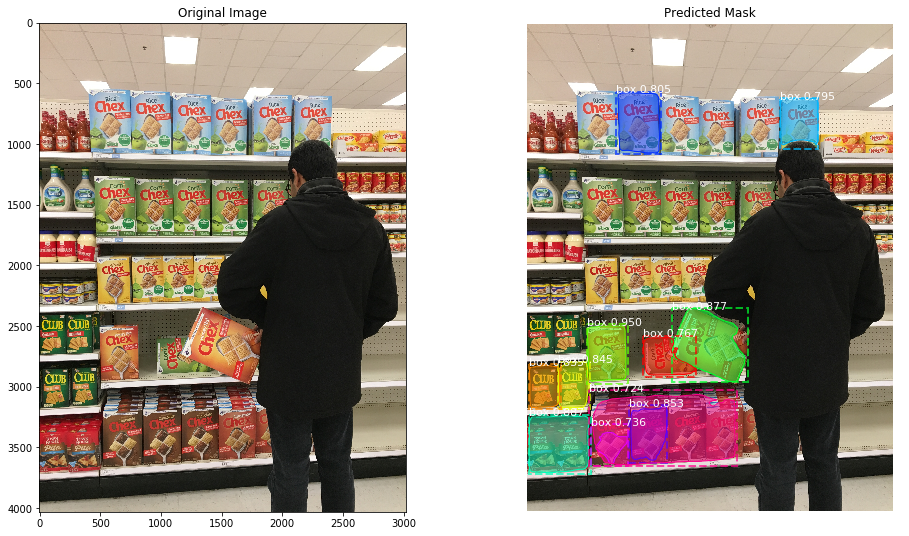

Number of boxes detected = 2


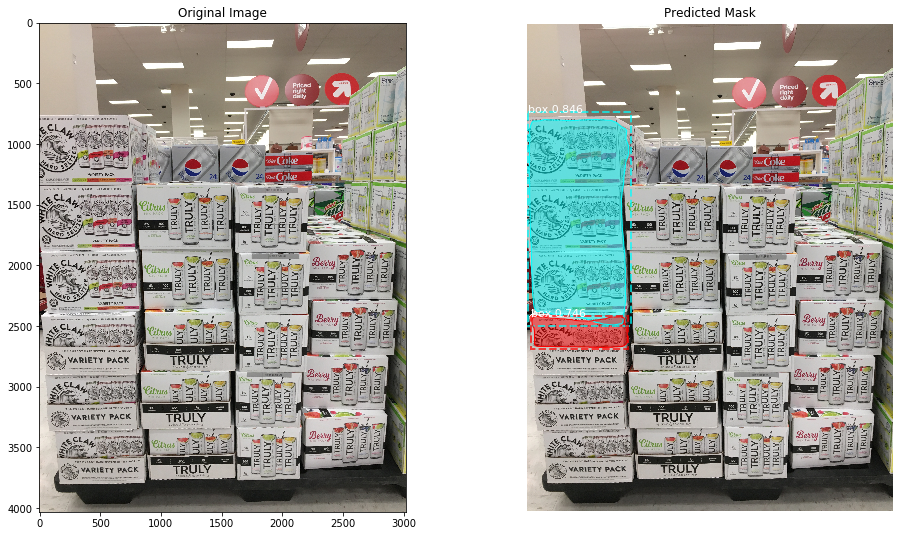

Number of boxes detected = 2


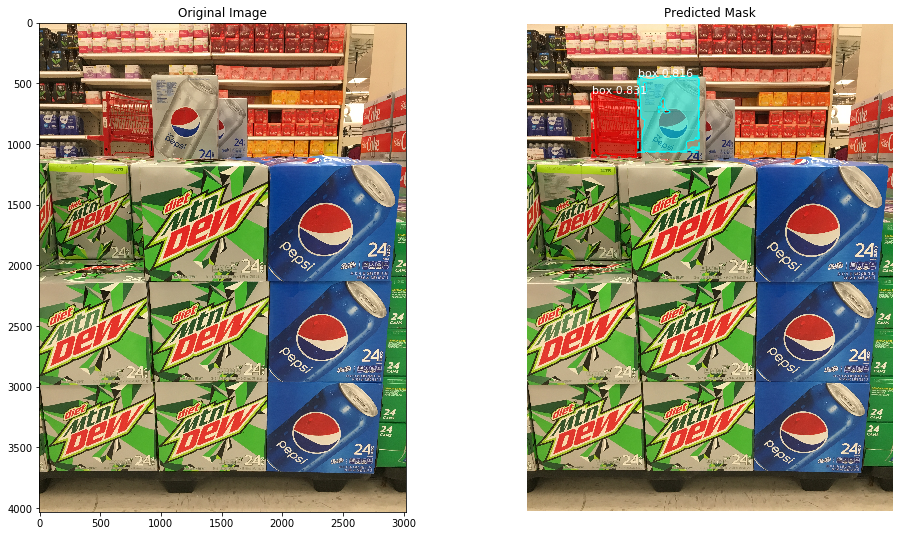

Number of boxes detected = 9


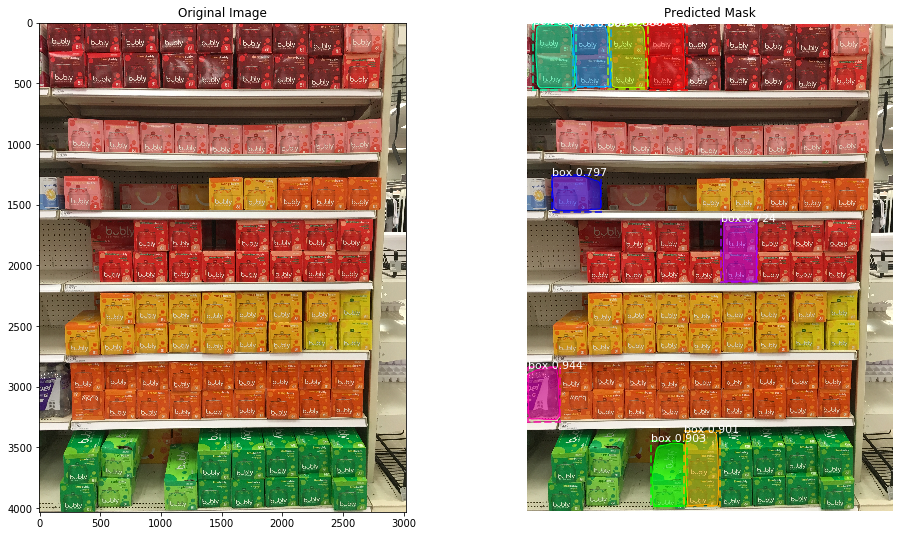

Number of boxes detected = 5


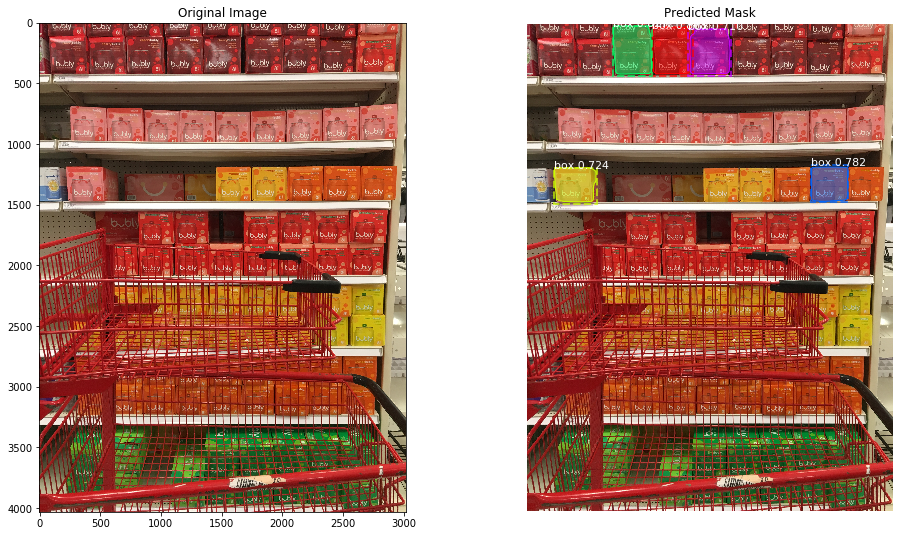

In [68]:
image_tag = 'box-shelf-eval'
for path in glob.glob('../data/%s/*'%image_tag):
    eval_single(image_tag, path[-12:])

Showing all labels

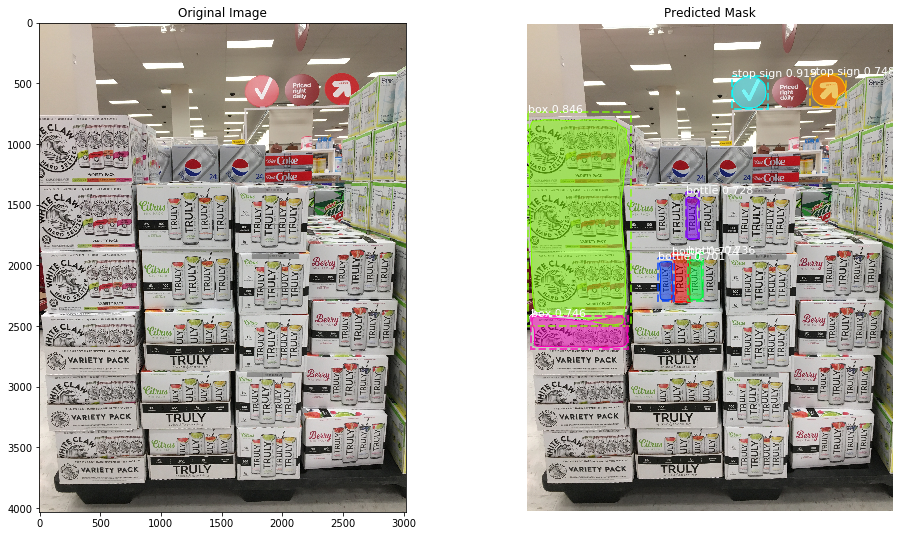

In [70]:
eval_single('box-shelf-eval', 'IMG_3773.JPG', filter_box=False)

Number of boxes detected = 1


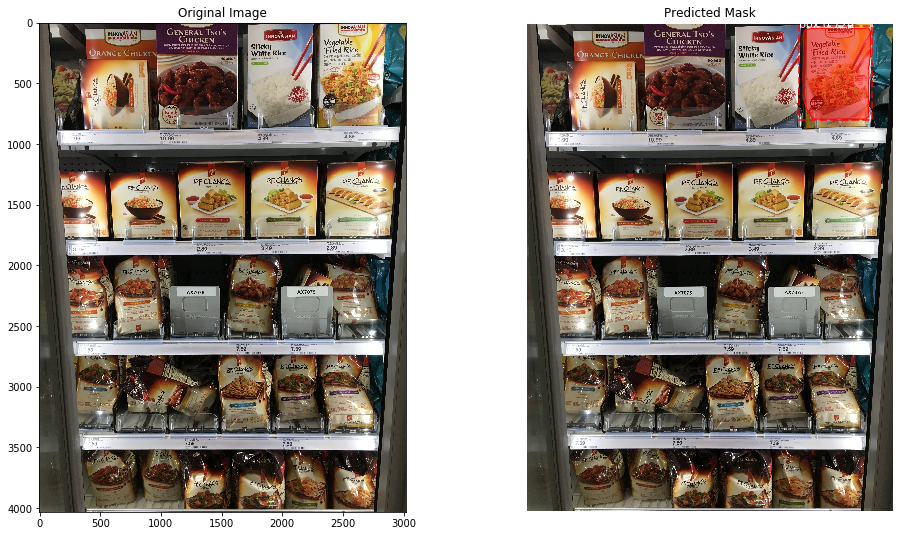

In [58]:
eval_single('box-fridge-eval', 'IMG_3808.JPG')

Bags on a Shelf/Fridge
---
Observations:
- Not doing well
- Not as robust to background and image depth as bottles

Number of boxes detected = 1


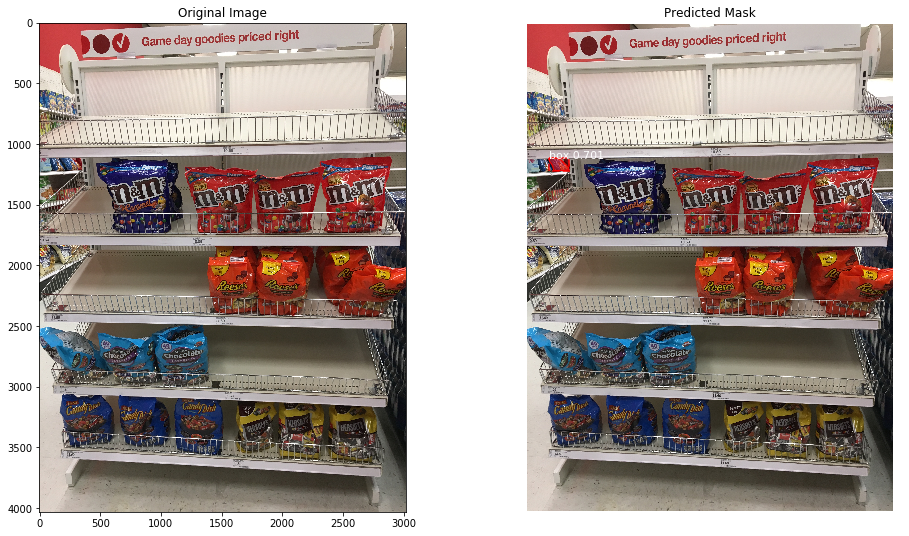

Number of boxes detected = 3


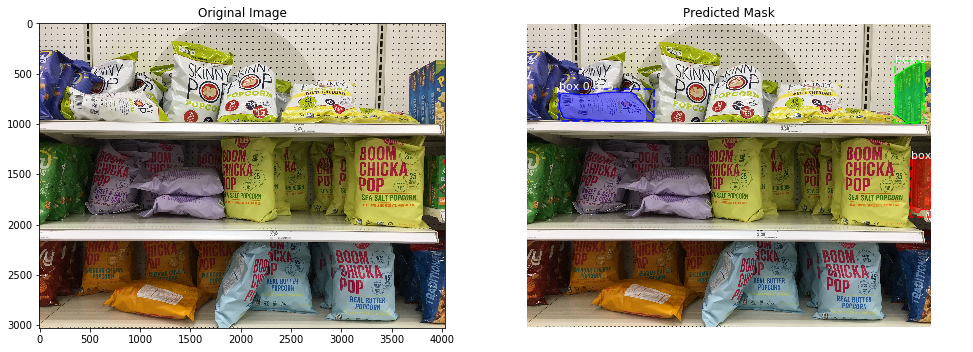

Number of boxes detected = 3


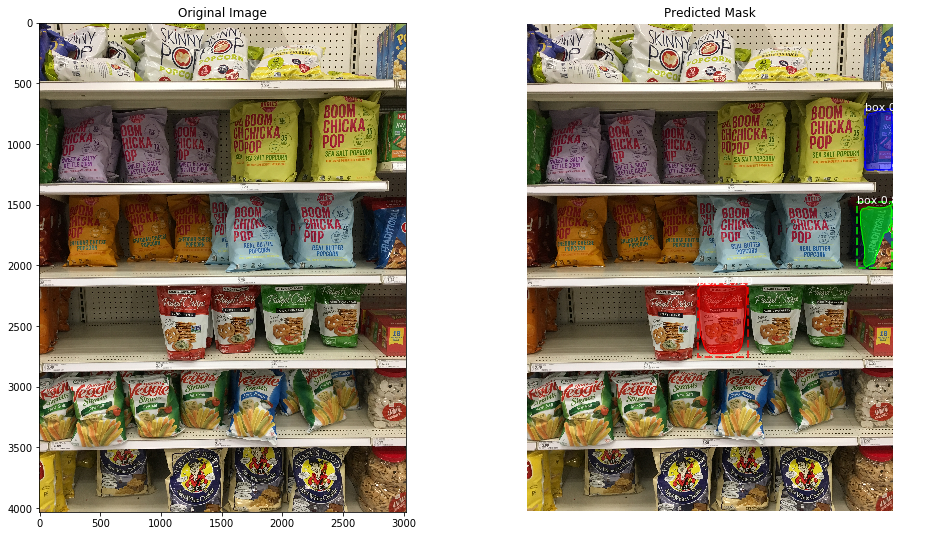

Number of boxes detected = 0

*** No instances to display *** 



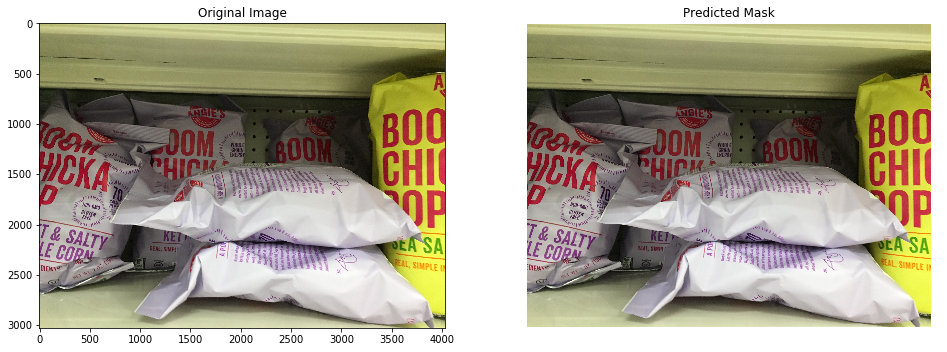

Number of boxes detected = 1


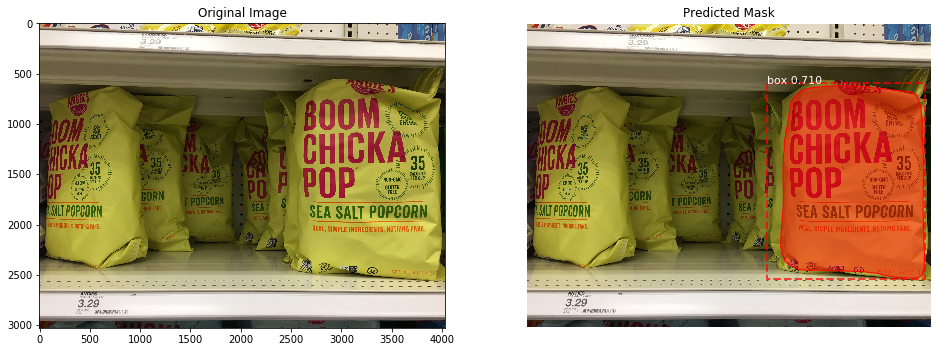

In [72]:
image_tag = 'bags-shelf-eval'
for path in glob.glob('../data/%s/*'%image_tag):
    eval_single(image_tag, path[-12:])

Number of boxes detected = 1


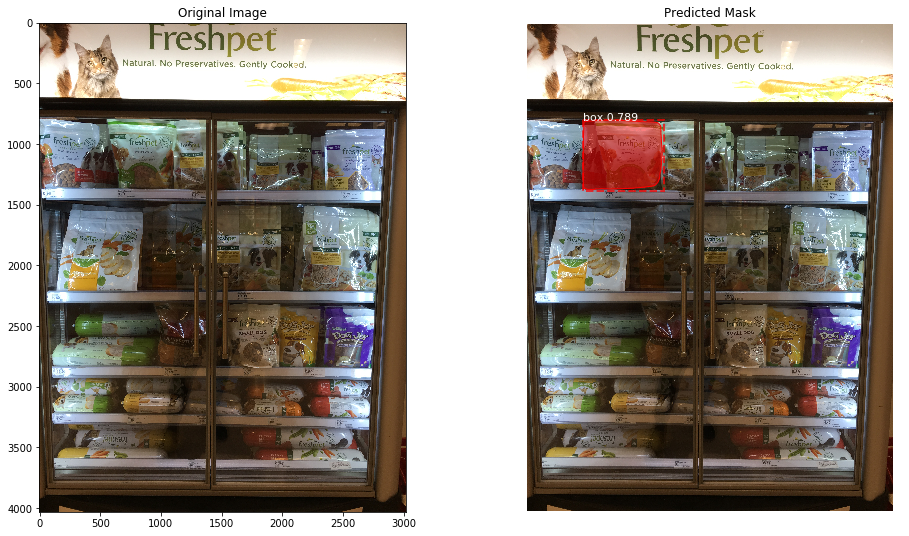

Number of boxes detected = 2


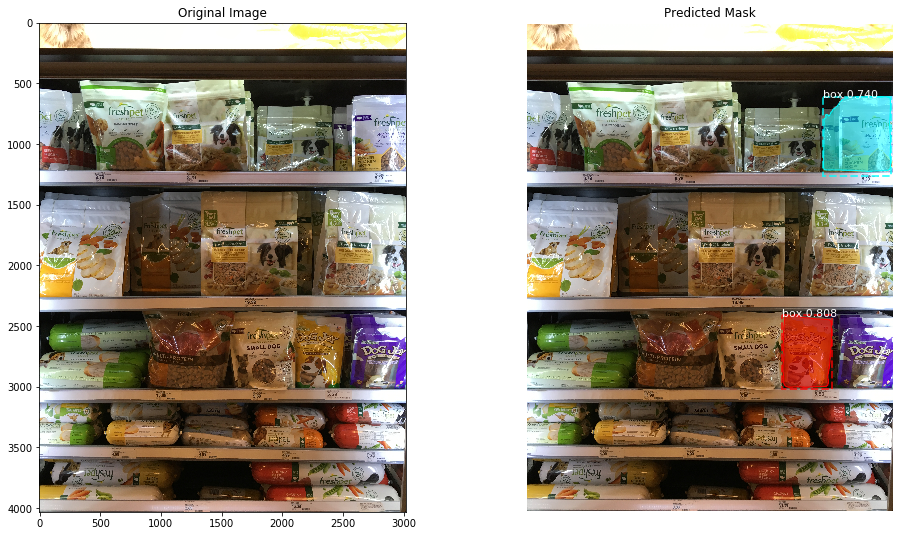

Number of boxes detected = 0

*** No instances to display *** 



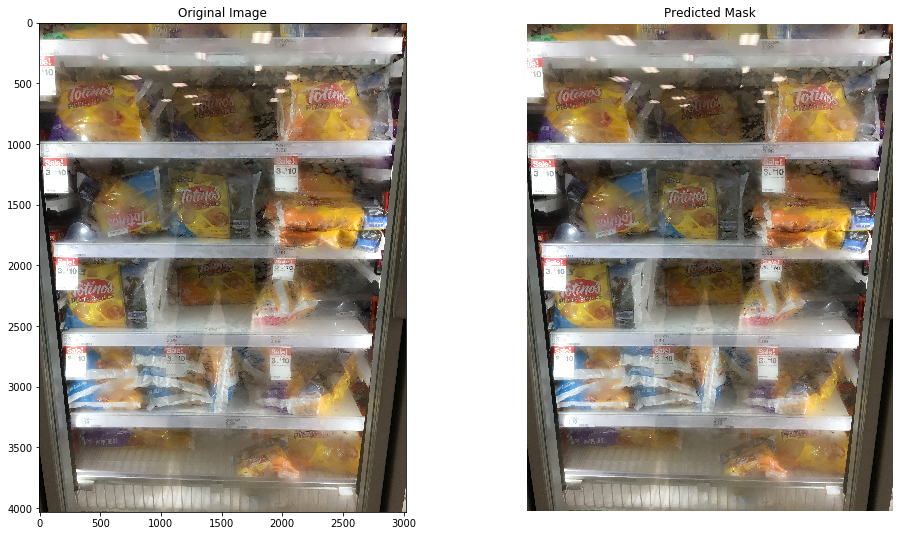

Number of boxes detected = 0

*** No instances to display *** 



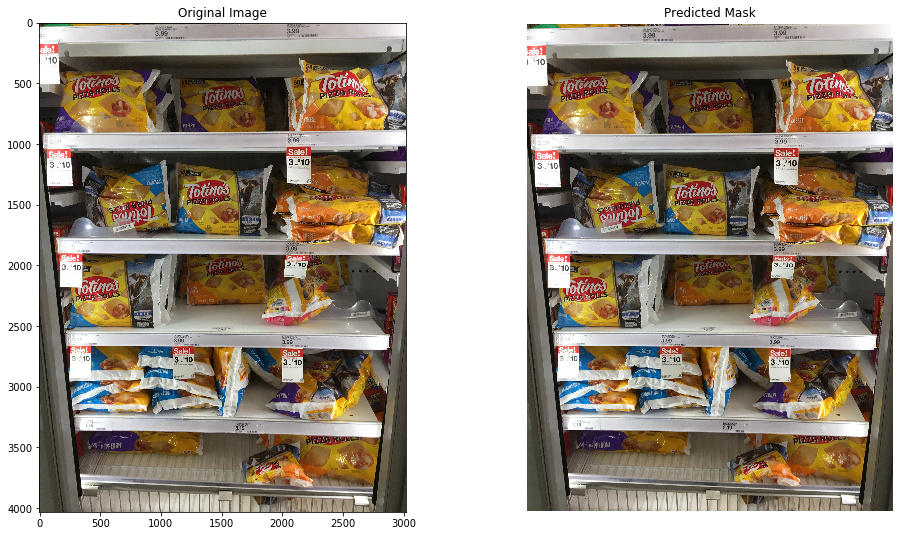

In [73]:
image_tag = 'bags-fridge-eval'
for path in glob.glob('../data/%s/*'%image_tag):
    eval_single(image_tag, path[-12:])

Boxes on a fake Shelf
---
Observations:
- Might be interesting to figure out why certain boxes are recognized but not others?

Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 89/89 [01:05<00:00,  1.40it/s]


Number of boxes detected = 8


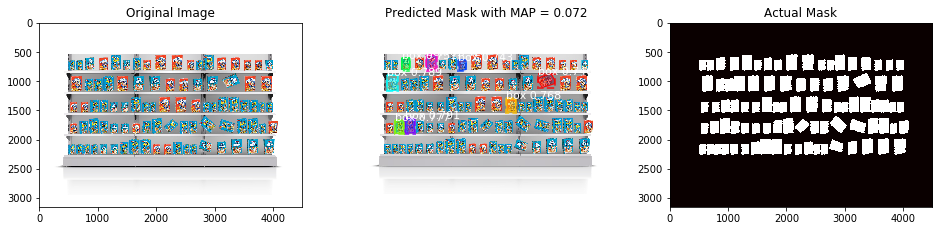

In [39]:
eval_single('fake-boxes/synth_data_2019_01_23_03_30_55/image_0_2019_01_23_03_30_55', 'image_0_2019_01_23_03_30_55.jpg', fake=True)

CPU times: user 21 µs, sys: 18 µs, total: 39 µs
Wall time: 68.7 µs


Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 79/79 [00:57<00:00,  1.37it/s]


Number of boxes detected = 9


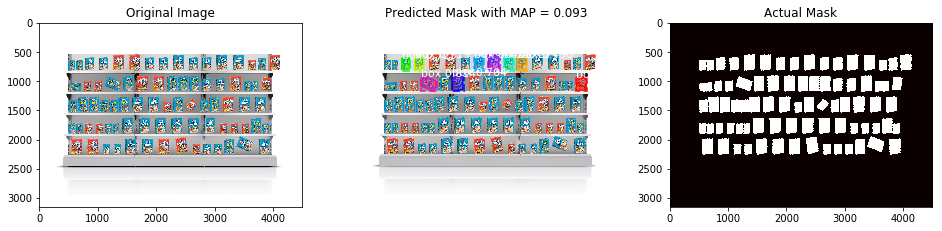

In [35]:
%time
eval_single('fake-boxes/synth_data_2019_01_23_03_30_55/image_2_2019_01_23_03_30_55', 'image_2_2019_01_23_03_30_55.jpg', fake=True)

CPU times: user 0 ns, sys: 28 µs, total: 28 µs
Wall time: 57.7 µs


Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 78/78 [00:56<00:00,  1.26it/s]


Number of boxes detected = 7


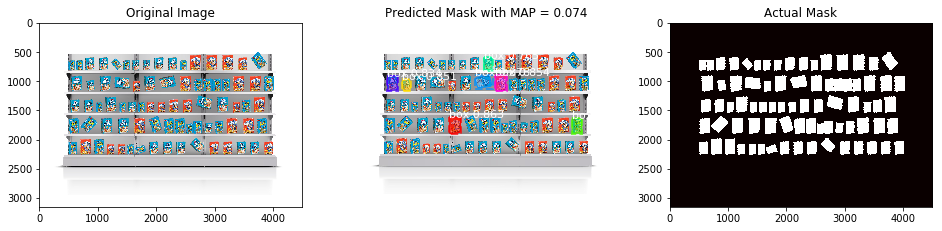

In [36]:
%time
eval_single('fake-boxes/synth_data_2019_01_23_03_30_55/image_3_2019_01_23_03_30_55', 'image_3_2019_01_23_03_30_55.jpg', fake=True)

CPU times: user 9 µs, sys: 9 µs, total: 18 µs
Wall time: 38.9 µs


Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 77/77 [00:55<00:00,  1.42it/s]


Number of boxes detected = 4


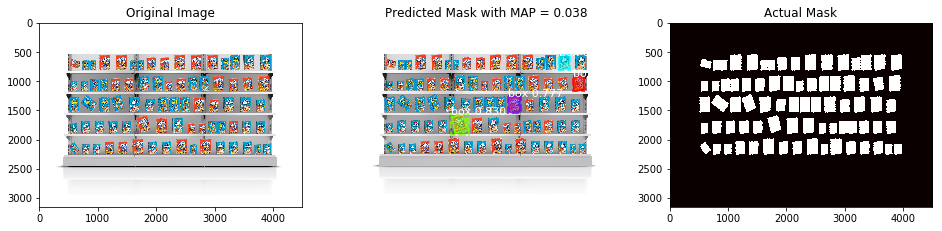

In [37]:
%time
eval_single('fake-boxes/synth_data_2019_01_23_03_30_55/image_4_2019_01_23_03_30_55', 'image_4_2019_01_23_03_30_55.jpg', fake=True)

CPU times: user 9 µs, sys: 8 µs, total: 17 µs
Wall time: 37.2 µs


Masks: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 87/87 [01:02<00:00,  1.40it/s]


Number of boxes detected = 9


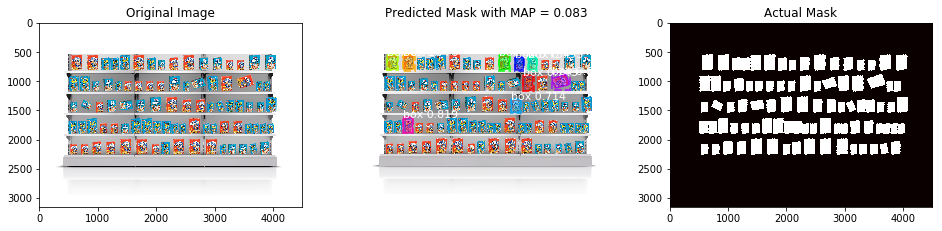

In [38]:
%time
eval_single('fake-boxes/synth_data_2019_01_23_03_30_55/image_5_2019_01_23_03_30_55', 'image_5_2019_01_23_03_30_55.jpg', fake=True)